# CAM304

## REDES NEURAIS E APRENDIZAGEM EM PROFUNDIDADE

## Regressão Logística e Rede Neural

### Aluno : Rafael Pires Mota

### Prof. Eduardo Luz / eduluz@ufop.edu.br

Objetivos:

- *Overfitting*
- Regularização

Data da entrega : a ser definido

- Complete o código (marcado com ToDo) e quando requisitado, escreva textos diretamente nos notebooks. Onde tiver *None*, substitua pelo seu código.
- Crie um repositório no github para o grupo e me convide como colaborador (eduluzufop). Por fim, me envie o link do github.



# *Overfitting* e *Underfitting*

## Importando os pacotes e funções auxiliares


In [1]:
import numpy as np
import pathlib
import shutil
import tempfile

from  IPython import display
from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import regularizers

In [2]:
prop_cycle = plt.rcParams['axes.prop_cycle']
COLOR_CYCLE = prop_cycle.by_key()['color']

def _smooth(values, std):
  """Smooths a list of values by convolving with a Gaussian distribution.
  Assumes equal spacing.
  Args:
    values: A 1D array of values to smooth.
    std: The standard deviation of the Gaussian distribution. The units are
      array elements.
  Returns:
    The smoothed array.
  """
  width = std * 4
  x = np.linspace(-width, width, min(2 * width + 1, len(values)))
  kernel = np.exp(-(x / 5)**2)

  values = np.array(values)
  weights = np.ones_like(values)

  smoothed_values = np.convolve(values, kernel, mode='same')
  smoothed_weights = np.convolve(weights, kernel, mode='same')

  return smoothed_values / smoothed_weights

class HistoryPlotter(object):
  """A class for plotting a named set of Keras-histories.
  The class maintains colors for each key from plot to plot.
  """

  def __init__(self, metric=None, smoothing_std=None):
    self.color_table = {}
    self.metric = metric
    self.smoothing_std = smoothing_std

  def plot(self, histories, metric=None, smoothing_std=None):
    """Plots a {name: history} dictionary of Keras histories.
    Colors are assigned to the name-key, and maintained from call to call.
    Training metrics are shown as a solid line, validation metrics dashed.
    Args:
      histories: {name: history} a dictionary of Keras histories.
      metric: which metric to plot from all the histories.
      smoothing_std: the standard deviation of the smoothing kernel applied
        before plotting. The units are in array-indices.
    """
    if metric is None:
      metric = self.metric
    if smoothing_std is None:
      smoothing_std = self.smoothing_std

    for name, history in histories.items():
      # Remember name->color associations.
      if name in self.color_table:
        color = self.color_table[name]
      else:
        color = COLOR_CYCLE[len(self.color_table) % len(COLOR_CYCLE)]
        self.color_table[name] = color

      train_value = history.history[metric]
      val_value = history.history['val_' + metric]
      if smoothing_std is not None:
        train_value = _smooth(train_value, std=smoothing_std)
        val_value = _smooth(val_value, std=smoothing_std)

      plt.plot(
          history.epoch,
          train_value,
          color=color,
          label=name.title() + ' Train')
      plt.plot(
          history.epoch,
          val_value,
          '--',
          label=name.title() + ' Val',
          color=color)

    plt.xlabel('Epochs')
    plt.ylabel(metric.replace('_', ' ').title())
    plt.legend()

    plt.xlim(
        [0, max([history.epoch[-1] for name, history in histories.items()])])
    plt.grid(True)

class EpochDots(tf.keras.callbacks.Callback):
  """A simple callback that prints a "." every epoch, with occasional reports.
  Args:
    report_every: How many epochs between full reports
    dot_every: How many epochs between dots.
  """

  def __init__(self, report_every=100, dot_every=1):
    self.report_every = report_every
    self.dot_every = dot_every

  def on_epoch_end(self, epoch, logs):
    if epoch % self.report_every == 0:
      print()
      print('Epoch: {:d}, '.format(epoch), end='')
      for name, value in sorted(logs.items()):
        print('{}:{:0.4f}'.format(name, value), end=',  ')
      print()

    if epoch % self.dot_every == 0:
      print('.', end='', flush=True)


## Importando os dados e algumas constantes

Algumas constantes também podem ajudar:

In [3]:
FEATURES = 28
BATCH_SIZE = 500
N_VALIDATION = int(1e3)
N_TRAIN = int(1e4)

Iremos trabalhar com o conjunto de dados de Higgs. O objetivo não é fazer física de partículas ou se preocupar com detalhes do conjunto de dados. O importante de entender é que ele contém 11.000.000 amostras, cada um com 28 características (`FEATURES`) e um rótulo de classe binária.

In [4]:
gz = tf.keras.utils.get_file('HIGGS.csv.gz', 'http://mlphysics.ics.uci.edu/data/higgs/HIGGS.csv.gz')

2816407858/2816407858 ━━━━━━━━━━━━━━━━━━━━ 383s 0us/step


A classe `tf.data.experimental.CsvDataset` pode ser usada para ler registros csv diretamente de um arquivo gzip sem etapa de descompactação intermediária.

In [5]:
ds = tf.data.experimental.CsvDataset(gz,[float(),]*(FEATURES+1), compression_type="GZIP")

Essa classe de leitor de csv retorna uma lista de escalares para cada registro. A função a seguir reempacota essa lista de escalares em um par (feature_vector, label).

O TensorFlow é mais eficiente ao operar em grandes lotes de dados. Portanto, em vez de reempacotar cada linha individualmente, criaremos um novo conjunto de Dataset que receba lotes de 10.000 exemplos, aplique a função `pack_row` a cada lote e, em seguida, divida os lotes em registros individuais:

In [6]:
def pack_row(*row):
  label = row[0]
  features = tf.stack(row[1:],1)
  return features, label

packed_ds = ds.batch(10000).map(pack_row).unbatch()

## Analisando os dados lidos

tf.Tensor(
[ 0.8692932  -0.6350818   0.22569026  0.32747006 -0.6899932   0.75420225
 -0.24857314 -1.0920639   0.          1.3749921  -0.6536742   0.9303491
  1.1074361   1.1389043  -1.5781983  -1.0469854   0.          0.65792954
 -0.01045457 -0.04576717  3.1019614   1.35376     0.9795631   0.97807616
  0.92000484  0.72165745  0.98875093  0.87667835], shape=(28,), dtype=float32)


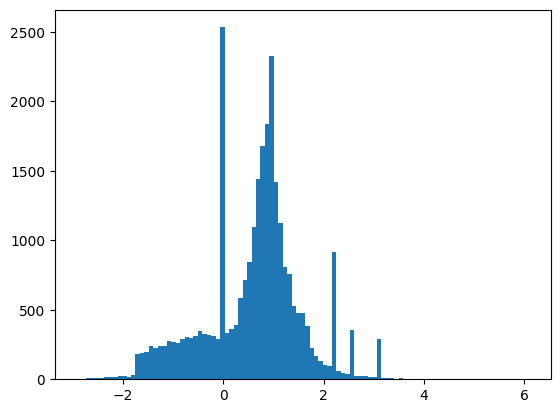

In [7]:
for features,label in packed_ds.batch(1000).take(1):
  print(features[0])
  plt.hist(features.numpy().flatten(), bins = 101)

11.000.000 de amostras é um número elevado de amostras para treino. Para essa prática, usaremos as 1.000 amostras para validação e as próximas 10.000 para treinamento.

Usaremos os métodos `Dataset.skip` e `Dataset.take` para facilitar esse processo.

In [8]:
validate_ds = packed_ds.take(N_VALIDATION).cache()
train_ds = packed_ds.skip(N_VALIDATION).take(N_TRAIN).cache()

## *Overfitting* (sobreajuste)

A maneira mais simples de evitar o *overfitting* é começar com um modelo pequeno: um modelo com um pequeno número de parâmetros (que é determinado pelo número de camadas e o número de unidades por camada). No aprendizado profundo, o número de parâmetros que podem ser aprendidos em um modelo é geralmente chamado de "capacidade" do modelo.

Intuitivamente, um modelo com mais parâmetros terá mais "capacidade de memorização" e, portanto, poderá aprender facilmente um mapeamento perfeito do tipo dicionário entre amostras de treinamento e seus alvos, um mapeamento sem nenhum poder de **generalização**, mas isso seria inútil ao fazer previsões em dados inéditos.

Sempre tenha isso em mente: os modelos de aprendizado profundo tendem a ser bons em se ajustar aos dados de treinamento, mas o verdadeiro desafio é a **generalização**, não o ajuste.

Por outro lado, se a rede tiver recursos de memorização limitados, ela não conseguirá aprender o mapeamento com tanta facilidade. Para minimizar sua perda, ele terá que aprender representações compactadas que tenham mais poder preditivo. Ao mesmo tempo, se você tornar seu modelo muito pequeno, ele terá dificuldade em se ajustar aos dados de treinamento. Há um equilíbrio entre "capacidade demais" e "capacidade de menos".

Infelizmente, não existe uma fórmula mágica para determinar o tamanho certo ou a arquitetura do seu modelo (em termos de número de camadas ou o tamanho certo para cada camada). Você terá que experimentar usando uma série de arquiteturas diferentes.

Para encontrar um tamanho de modelo apropriado, é melhor começar com relativamente poucas camadas e parâmetros e, em seguida, começar a aumentar o tamanho das camadas ou adicionar novas camadas até ver retornos decrescentes na perda de validação.

Comece com um modelo simples usando apenas `layers.Dense` como linha de base, depois crie versões maiores e compare-as.

## Configurando o treinamento de modelos

Nesta prática iremos avaliar diversos modelos. Para que a análise seja facilitada, usaremos a mesma configuração para todos os modelos.

- Muitos modelos treinam melhor se você reduzir gradualmente a taxa de aprendizado durante o treinamento. Uma forma de utilizar isso em TensorFlow é por meio dos `optimizers.schedules`, os quais variam a taxa de aprendizado ao longo do tempo. Nesta prática utilizaremos o `InverseTimeDecay`.
- Utilizaremos como base o otimizador `tf.keras.optimizers.Adam`, o qual usará o `InverseTimeDecay` para regular a taxa de aprendizado.

In [9]:
STEPS_PER_EPOCH = N_TRAIN // BATCH_SIZE # Total de amostras de treino / Batch size

lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
  0.001,
  decay_steps=STEPS_PER_EPOCH*1000,
  decay_rate=1,
  staircase=False)

def get_optimizer():
  return tf.keras.optimizers.Adam(lr_schedule)

O código acima define um `schedules.InverseTimeDecay` para diminuir hiperbolicamente a taxa de aprendizado para 1/2 da taxa básica em 1.000 épocas, 1/3 em 2.000 épocas e assim por diante.

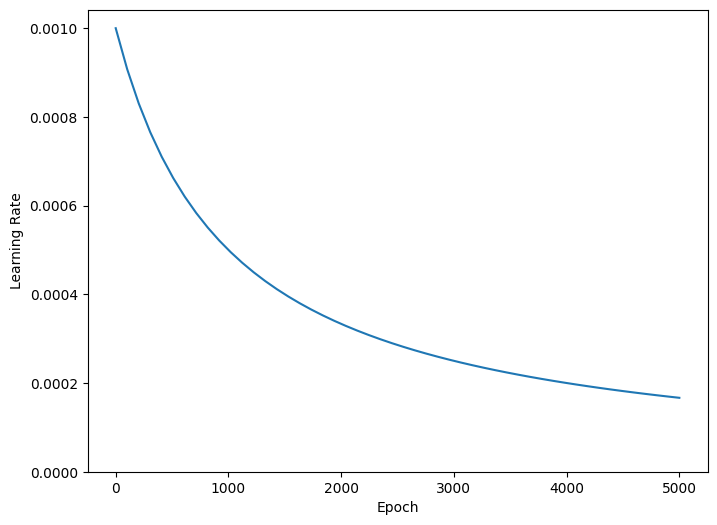

In [10]:
step = np.linspace(0,100000)
lr = lr_schedule(step)
plt.figure(figsize = (8,6))
plt.plot(step/STEPS_PER_EPOCH, lr)
plt.ylim([0,max(plt.ylim())])
plt.xlabel('Epoch')
_ = plt.ylabel('Learning Rate')

Outras Callbacks são necessárias:
- O treinamento para desta prática é executada por muitas épocas curtas. Para reduzir o ruído de log, use o `tfdocs.EpochDots` que simplesmente imprime `.` para cada época e um conjunto completo de métricas a cada 100 épocas.

- Para evitar tempos de treinamento longos e desnecessários, pode-se utilizar a `callbacks.EarlyStopping`. Observe que esse retorno de chamada é definido para monitorar o `val_binary_crossentropy` , não o `val_loss` . Essa diferença será importante mais tarde.
- Por fim, a `callbacks.TensorBoard` para gerar logs do TensorBoard para o treinamento.

In [11]:
logdir = pathlib.Path(tempfile.mkdtemp())/"tensorboard_logs"
shutil.rmtree(logdir, ignore_errors=True)

def get_callbacks(name):
  return [
    EpochDots(),
    tf.keras.callbacks.EarlyStopping(monitor='val_binary_crossentropy', patience=200),
    tf.keras.callbacks.TensorBoard(logdir/name),
  ]

Por fim, iremos definir uma função para treinar e compilar os modelos.

In [12]:
def compile_and_fit(model, name, max_epochs=10000):
  optimizer = get_optimizer()
  model.compile(optimizer=optimizer,
                loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
                metrics=[tf.keras.losses.BinaryCrossentropy(
                             from_logits=True,
                             name='binary_crossentropy'),
                         'accuracy'])

  model.summary()

  history = model.fit(
    train_ds,
    steps_per_epoch = STEPS_PER_EPOCH,
    epochs=max_epochs,
    validation_data=validate_ds,
    callbacks=get_callbacks(name),
    verbose=0)
  return history

## Treinando um modelo minúsculo

In [13]:
tiny_model = tf.keras.Sequential([
    layers.Dense(16, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(1)
])

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Criando uma variável para guardar a história dos modelos treinados.

In [14]:
size_histories = {}

Treinando o nosso pequeno modelo.

In [15]:
validate_ds = validate_ds.batch(BATCH_SIZE)
train_ds = train_ds.shuffle(int(1e4)).repeat().batch(BATCH_SIZE)

size_histories['Tiny'] = compile_and_fit(tiny_model, 'sizes/Tiny')

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 16)                  │             464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 481 (1.88 KB)

 Trainable params: 481 (1.88 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.4896,  binary_crossentropy:0.7798,  loss:0.7798,  val_accuracy:0.4750,  val_binary_crossentropy:0.5130,  val_loss:0.7695,  
...

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


.................................................................................................
Epoch: 100, accuracy:0.6102,  binary_crossentropy:0.6200,  loss:0.6200,  val_accuracy:0.5850,  val_binary_crossentropy:0.4130,  val_loss:0.6195,  
....................................................................................................
Epoch: 200, accuracy:0.6421,  binary_crossentropy:0.6031,  loss:0.6031,  val_accuracy:0.6330,  val_binary_crossentropy:0.3999,  val_loss:0.5999,  
....................................................................................................
Epoch: 300, accuracy:0.6557,  binary_crossentropy:0.5950,  loss:0.5950,  val_accuracy:0.6620,  val_binary_crossentropy:0.3941,  val_loss:0.5912,  
....................................................................................................
Epoch: 400, accuracy:0.6663,  binary_crossentropy:0.5900,  loss:0.5900,  val_accuracy:0.6220,  val_binary_crossentropy:0.3947,  val_loss:0.5921,  
...........

### Verificando o modelo

(0.5, 0.7)

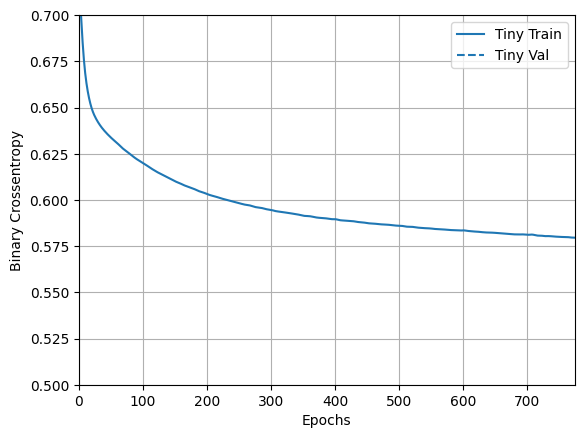

In [16]:
plotter = HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(size_histories)
plt.ylim([0.5, 0.7])

As linhas sólidas mostram a `loss` de treinamento e as linhas tracejadas mostram a `loss` de validação (lembre-se: uma `loss` de validação menor indica um modelo melhor).

## Treinando um modelo pequeno

Uma forma de tentar superar o desempenho do modelo minúsculo é treinando progressivamente alguns modelos maiores.

No modelo minúsculo usamos somente uma camada de 16 neurônios. Vamos experimentar com duas camadas ocultas com 16 unidades.

In [17]:
small_model = tf.keras.Sequential([
    layers.Dense(16, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(16, activation='elu'),
    layers.Dense(1)
])

In [18]:
size_histories['Small'] = compile_and_fit(small_model, 'sizes/Small')

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                      │ (None, 16)                  │             464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 16)                  │             272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 753 (2.94 KB)

 Trainable params: 753 (2.94 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.4867,  binary_crossentropy:0.7481,  loss:0.7481,  val_accuracy:0.4650,  val_binary_crossentropy:0.4840,  val_loss:0.7260,  
....................................................................................................
Epoch: 100, accuracy:0.6178,  binary_crossentropy:0.6164,  loss:0.6164,  val_accuracy:0.5730,  val_binary_crossentropy:0.4176,  val_loss:0.6264,  
....................................................................................................
Epoch: 200, accuracy:0.6423,  binary_crossentropy:0.6017,  loss:0.6017,  val_accuracy:0.6300,  val_binary_crossentropy:0.4093,  val_loss:0.6139,  
....................................................................................................
Epoch: 300, accuracy:0.6581,  binary_crossentropy:0.5868,  loss:0.5868,  val_accuracy:0.6310,  val_binary_crossentropy:0.3999,  val_loss:0.5999,  
....................................................................................................
Epoch: 40

### Verificando ambos modelos treinados

(0.5, 0.7)

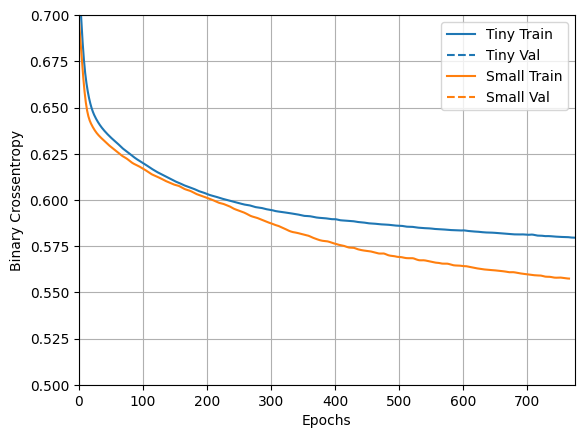

In [19]:
plotter = HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(size_histories)
plt.ylim([0.5, 0.7])

## Treinando um modelo médio

Vamos tentar agora um modelo com 3 camadas e 64 neurônios por camada (quatro vezes mais).

In [20]:
medium_model = tf.keras.Sequential([
    layers.Dense(64, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(64, activation='elu'),
    layers.Dense(64, activation='elu'),
    layers.Dense(1)
])

In [21]:
size_histories['Medium']  = compile_and_fit(medium_model, "sizes/Medium")

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_5 (Dense)                      │ (None, 64)                  │           1,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 64)                  │           4,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 64)                  │           4,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,241 (40.00 KB)

 Trainable params: 10,241 (40.00 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.4815,  binary_crossentropy:0.7026,  loss:0.7026,  val_accuracy:0.4740,  val_binary_crossentropy:0.4564,  val_loss:0.6846,  
....................................................................................................
Epoch: 100, accuracy:0.7036,  binary_crossentropy:0.5407,  loss:0.5407,  val_accuracy:0.6460,  val_binary_crossentropy:0.4147,  val_loss:0.6220,  
....................................................................................................
Epoch: 200, accuracy:0.7732,  binary_crossentropy:0.4420,  loss:0.4420,  val_accuracy:0.6480,  val_binary_crossentropy:0.4617,  val_loss:0.6926,  
........................................................................................

### Verificando os modelos treinados

(0.3, 0.7)

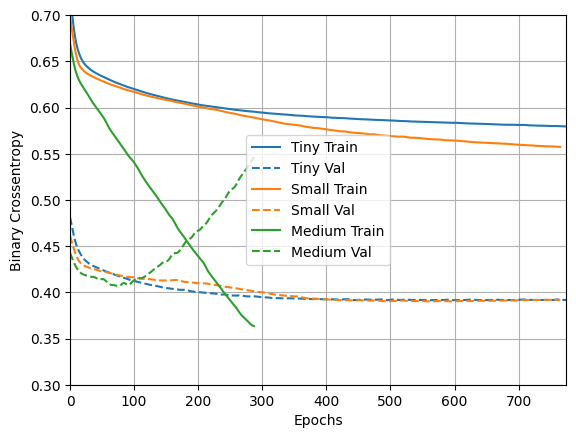

In [22]:
plotter = HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(size_histories)
plt.ylim([0.3, 0.7])

## Treinando um modelo grande

Você pode criar um modelo ainda maior e verificar a rapidez com que ele começa a fazer overfitting. O novo modelo possui mais camadas e mais neurônios por camada (512).

In [23]:
large_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(1)
])

In [24]:
size_histories['large'] = compile_and_fit(large_model, "sizes/large")

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_9 (Dense)                      │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5077,  binary_crossentropy:0.7694,  loss:0.7694,  val_accuracy:0.5390,  val_binary_crossentropy:0.4455,  val_loss:0.6683,  
....................................................................................................
Epoch: 100, accuracy:1.0000,  binary_crossentropy:0.0021,  loss:0.0021,  val_accuracy:0.6620,  val_binary_crossentropy:1.1320,  val_loss:1.6980,  
....................................................................................................
Epoch: 200, accuracy:1.0000,  binary_crossentropy:0.0001,  loss:0.0001,  val_accuracy:0.6640,  val_binary_crossentropy:1.5324,  val_loss:2.2987,  
.............................

### Verificando os modelos treinados

Embora a construção de um modelo maior lhe dê mais poder, se esse poder não for restringido de alguma forma, ele pode facilmente se ajustar ao conjunto de treinamento.

Neste exemplo, normalmente, apenas o modelo minúsculo (`"Tiny"`) consegue evitar completamente o overfitting, e cada um dos modelos maiores superajusta os dados mais rapidamente. Isso se torna tão grave para o modelo grande (`"Large"`) que você precisa mudar o gráfico para uma escala logarítmica para realmente descobrir o que está acontecendo.

Isso fica aparente se você plotar e comparar as métricas de validação com as métricas de treinamento.

* É normal que haja uma pequena diferença.
* Se ambas as métricas estiverem se movendo na mesma direção, está tudo bem.
* Se a métrica de validação começar a estagnar enquanto a métrica de treinamento continua a melhorar, você provavelmente está perto do overfitting.
* Se a métrica de validação estiver indo na direção errada, o modelo está claramente superajustado.

Text(0.5, 0, 'Epochs [Log Scale]')

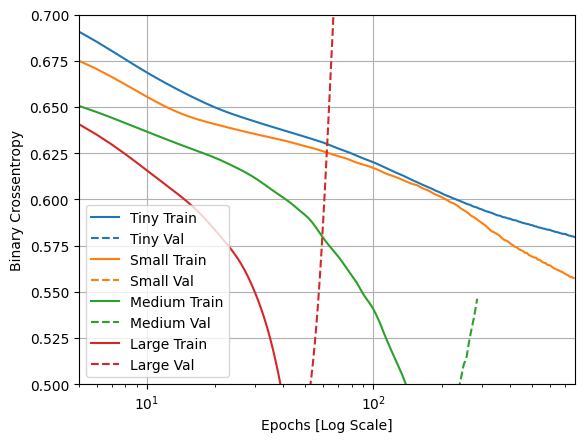

In [25]:
plotter.plot(size_histories)
a = plt.xscale('log')
plt.xlim([5, max(plt.xlim())])
plt.ylim([0.5, 0.7])
plt.xlabel("Epochs [Log Scale]")

Todas as execuções de treinamento acima usaram o `callbacks.EarlyStopping` para encerrar o treinamento, uma vez que ficou claro que o modelo não estava progredindo.

## **ToDo:** Avaliando um modelo gigante (10pt)

Adicione a esse *benchmark* uma rede que tenha muito mais capacidade, muito mais do que o problema precisa.

In [30]:
giant_model = tf.keras.Sequential([
    layers.Dense(1024, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(1024, activation='elu'),
    layers.Dense(1024, activation='elu'),
    layers.Dense(1024, activation='elu'),
    layers.Dense(1)
])


In [32]:
size_histories['Giant'] = compile_and_fit(giant_model, "sizes/Giant")


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_24 (Dense)                     │ (None, 1024)                │          29,696 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_25 (Dense)                     │ (None, 1024)                │       1,049,600 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_26 (Dense)                     │ (None, 1024)                │       1,049,600 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_27 (Dense)                     │ (None, 1024)                │       1,049,600 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_28 (Dense)                     │ (None, 1)                   │           1,025 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,179,521 (12.13 MB)

 Trainable params: 3,179,521 (12.13 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5414,  binary_crossentropy:0.7347,  loss:0.7347,  val_accuracy:0.5190,  val_binary_crossentropy:0.4552,  val_loss:0.6828,  
....................................................................................................
Epoch: 100, accuracy:1.0000,  binary_crossentropy:0.0005,  loss:0.0005,  val_accuracy:0.6700,  val_binary_crossentropy:1.2827,  val_loss:1.9241,  
....................................................................................................
Epoch: 200, accuracy:1.0000,  binary_crossentropy:0.0000,  loss:0.0000,  val_accuracy:0.6720,  val_binary_crossentropy:1.5850,  val_loss:2.3775,  
....................

Text(0.5, 0, 'Epochs [Log Scale]')

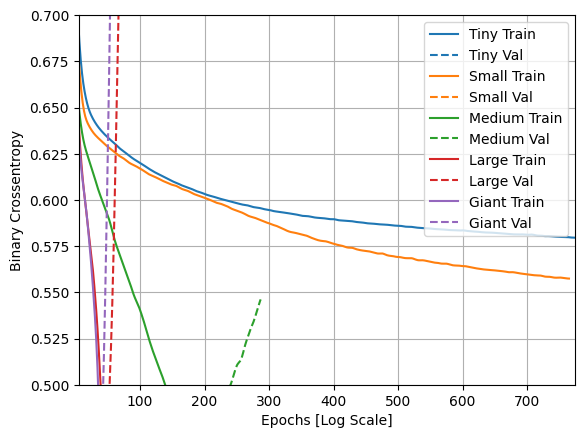

In [33]:
plotter.plot(size_histories)
plt.xlim([5, max(plt.xlim())])
plt.ylim([0.5, 0.7])
plt.xlabel("Epochs [Log Scale]")

### **ToDo:** Avalie o seu modelo treinado conforme foi feito nos exemplos anteriores (10pt)

O modelo gigante apresentou um claro overfitting, evidenciado pela diferença crescente entre a perda de treinamento e a perda de validação. Enquanto a perda de treinamento continuou diminuindo, a perda de validação estagnou, mostrando que o modelo memorizou os dados de treinamento, mas não generalizou bem para dados novos. Modelos menores, como "Tiny" e "Small", apresentaram uma melhor generalização.

## Avaliando os resultados no *TensorBoard*

Salvamos os logs do TensorBoard durante o treinamento de todos os modelos treinados.

Podemos abrir um visualizador TensorBoard incorporado em um notebook.

In [34]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# Open an embedded TensorBoard viewer
%tensorboard --logdir {logdir}/sizes

<IPython.core.display.Javascript object>

### **ToDo:** Análises (10pt)

Quais análises você pode fazer sobre o TensorBoard?

O modelo gigante apresentou alta acurácia no conjunto de treinamento, mas a acurácia de validação se estabilizou em um valor menor, indicando overfitting. Em contrapartida, o modelo "Tiny" conseguiu manter acurácias de validação mais próximas das de treinamento, demonstrando uma melhor generalização. A perda de validação do modelo gigante aumentou significativamente enquanto a perda de treinamento continuou caindo, reforçando a falta de capacidade de generalização. A redução gradual da taxa de aprendizado ao longo das épocas ajudou na estabilização do treinamento dos modelos menores, melhorando a convergência. Em resumo, os modelos menores mostraram melhor generalização e resistência ao overfitting, enquanto os maiores, como o "Giant", tiveram dificuldades em generalizar bem.

# Estratégias para previnir *overfitting* (sobreajuste)

Antes de entrar no conteúdo desta seção, copie os logs de treinamento do modelo minúsculo (`"Tiny"`) acima, para usar como linha de base para comparação.

Iremos comparar os logs de treinamento do modelo minúsculo (`"Tiny"`) acima, por isso iremos copiar os logs.

In [35]:
shutil.rmtree(logdir/'regularizers/Tiny', ignore_errors=True)
shutil.copytree(logdir/'sizes/Tiny', logdir/'regularizers/Tiny')

PosixPath('/tmp/tmp_1dluoyr/tensorboard_logs/regularizers/Tiny')

In [36]:
regularizer_histories = {}
regularizer_histories['Tiny'] = size_histories['Tiny']

### Adicionando estratégias de regularização ao modelo


Você pode estar familiarizado com o princípio da Navalha de Occam: dadas duas explicações para algo, a explicação mais provável de ser correta é a **mais simples**, aquela que faz a menor quantidade de suposições. Isso também se aplica aos modelos aprendidos pelas redes neurais: dados alguns dados de treinamento e uma arquitetura de rede, existem vários conjuntos de valores de pesos (múltiplos modelos) que podem explicar os dados, e modelos mais simples são menos propensos a sobreajustar do que os complexos.

Um "modelo simples" neste contexto é um modelo onde a distribuição de valores de parâmetros tem menos entropia (ou um modelo com menos parâmetros, como demonstrado na seção acima). Assim, uma maneira comum de mitigar o *overfitting* é colocar restrições na complexidade de uma rede, forçando seus pesos apenas a assumir valores pequenos, o que torna a distribuição de valores de peso mais "regular". Isso é chamado de "regularização de peso", e é feito adicionando à função de perda da rede um custo associado a ter grandes pesos. Este custo vem em dois sabores:

* [Regularização L1](https://developers.google.com/machine-learning/glossary/#L1_regularization), onde o custo adicionado é proporcional ao valor absoluto dos coeficientes dos pesos (ou seja, ao que é chamado de "norma L1 "dos pesos).

* [Regularização L2](https://developers.google.com/machine-learning/glossary/#L2_regularization), onde o custo adicionado é proporcional ao quadrado do valor dos coeficientes dos pesos (ou seja, ao que é chamado de quadrado "norma L2" dos pesos). A regularização L2 também é chamada de decaimento de peso no contexto de redes neurais. Não deixe que o nome diferente o confunda: a redução de peso (*weight decay*) é matematicamente igual à regularização L2.

A regularização L1 empurra os pesos para zero, incentivando um modelo esparso. A regularização de L2 penalizará os parâmetros de pesos sem torná-los esparsos, já que a penalidade vai para zero para pesos pequenos - uma razão pela qual L2 é mais comum.

Em `tf.keras`, a regularização de peso é adicionada passando instâncias do regularizador de peso para camadas como argumentos de palavras-chave. Adicione regularização de peso L2:

In [37]:
l2_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001), input_shape=(FEATURES,)),
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(1)
])

regularizer_histories['l2'] = compile_and_fit(l2_model, "regularizers/l2")

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_29 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_30 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_31 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_32 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_33 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5056,  binary_crossentropy:0.8100,  loss:2.3267,  val_accuracy:0.4770,  val_binary_crossentropy:0.4660,  val_loss:2.1369,  
.

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


...................................................................................................
Epoch: 100, accuracy:0.6489,  binary_crossentropy:0.5975,  loss:0.6183,  val_accuracy:0.6820,  val_binary_crossentropy:0.3960,  val_loss:0.6148,  
....................................................................................................
Epoch: 200, accuracy:0.6724,  binary_crossentropy:0.5812,  loss:0.6047,  val_accuracy:0.6390,  val_binary_crossentropy:0.3919,  val_loss:0.6113,  
....................................................................................................
Epoch: 300, accuracy:0.6763,  binary_crossentropy:0.5755,  loss:0.6001,  val_accuracy:0.6690,  val_binary_crossentropy:0.3897,  val_loss:0.6092,  
....................................................................................................
Epoch: 400, accuracy:0.6888,  binary_crossentropy:0.5641,  loss:0.5877,  val_accuracy:0.6750,  val_binary_crossentropy:0.3884,  val_loss:0.6061,  
.........

`l2(0,001)` significa que cada coeficiente na matriz de peso da camada adicionará `0,001 * weight_coeficiente_value**2` ao total de **perda** da rede.

É por isso que estamos monitorando o `binary_crossentropy` diretamente. Porque não tem esse componente de regularização misturado.

Então, esse mesmo modelo `"Large"` com uma penalidade de regularização `L2` tem um desempenho muito melhor:


(0.5, 0.7)

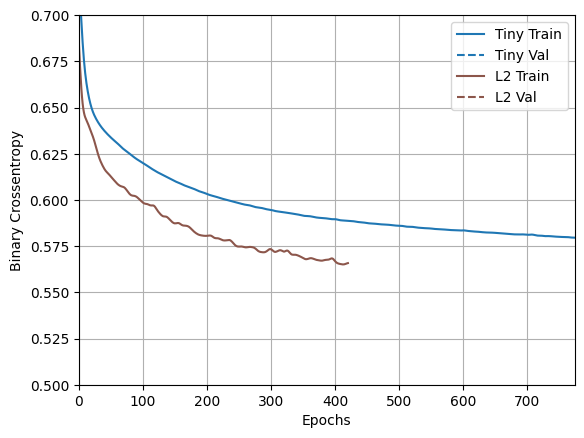

In [38]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

Conforme demonstrado, o modelo regularizado `"L2"` agora é muito mais competitivo com o modelo `"Tiny"`. Este modelo `"L2"` também é muito mais resistente ao overfitting do que o modelo `"Large"` no qual foi baseado, apesar de ter o mesmo número de parâmetros.

### Adicionando *dropout*

Dropout é uma das técnicas de regularização mais eficazes e mais utilizadas para redes neurais, desenvolvida por Hinton e seus alunos da Universidade de Toronto.

A explicação intuitiva para o dropout é que, como os nós individuais na rede não podem contar com a saída dos outros, cada nó deve produzir recursos que sejam úteis por conta própria.

O dropout, aplicado a uma camada, consiste em "descartar" aleatoriamente (ou seja, definir como zero) um número de recursos de saída da camada durante o treinamento. Por exemplo, uma determinada camada normalmente retornaria um vetor `[0.2, 0.5, 1.3, 0.8, 1.1]` para uma determinada amostra de entrada durante o treinamento; após aplicar dropout, este vetor terá algumas entradas zero distribuídas aleatoriamente, por exemplo. `[0, 0,5, 1,3, 0, 1,1]`.

A "taxa de abandono" é a fração dos recursos que estão sendo zerados; geralmente é definido entre 0,2 e 0,5. No momento do teste, nenhuma unidade é descartada e, em vez disso, os valores de saída da camada são reduzidos por um fator igual à taxa de abandono, de modo a equilibrar o fato de que mais unidades estão ativas do que no tempo de treinamento.

No Keras, você pode introduzir dropout em uma rede através da camada `tf.keras.layers.Dropout`, que é aplicada à saída da camada imediatamente anterior.

Adicione duas camadas de dropout à sua rede para verificar o desempenho delas na redução do overfitting:

In [39]:
dropout_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', input_shape=(FEATURES,)),
    layers.Dropout(0.5),
    layers.Dense(512, activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(512, activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(512, activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(1)
])

regularizer_histories['dropout'] = compile_and_fit(dropout_model, "regularizers/dropout")

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_34 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_35 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_36 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_37 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_38 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5002,  binary_crossentropy:0.7996,  loss:0.7996,  val_accuracy:0.5520,  val_binary_crossentropy:0.4537,  val_loss:0.6806,  
....................................................................................................
Epoch: 100, accuracy:0.6574,  binary_crossentropy:0.5925,  loss:0.5925,  val_accuracy:0.6910,  val_binary_crossentropy:0.3838,  val_loss:0.5758,  
....................................................................................................
Epoch: 200, accuracy:0.6863,  binary_crossentropy:0.5572,  loss:0.5572,  val_accuracy:0.6670,  val_binary_crossentropy:0.3891,  val_loss:0.5837,  
....................................................................................................
Epoch: 300, accuracy:0.7182,  binary_crossentropy:0.5182,  loss:0.5182,  val_accuracy:0.6710,  val_binary_crossentropy:0.3946,  val_loss:0.5919,  
...................................

(0.5, 0.7)

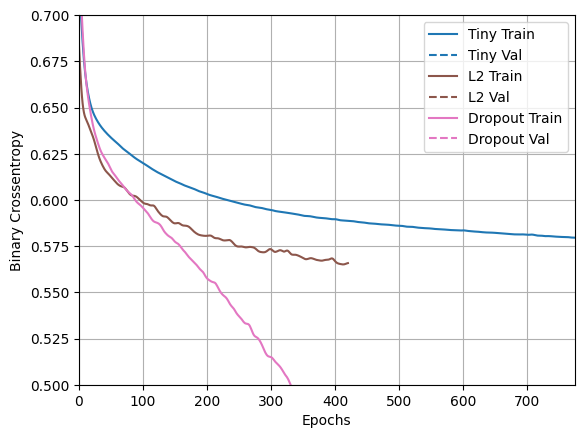

In [40]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

Fica claro neste gráfico que ambas as abordagens de regularização melhoram o comportamento do modelo grande (`"Large"`). Mas isso ainda não supera nem mesmo a linha de base `"Tiny"`.

Naturalmente, o próximo passo é testar os dois juntos.

### Combinando L2 + *dropout*

In [41]:
combined_model = tf.keras.Sequential([
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu', input_shape=(FEATURES,)),
    layers.Dropout(0.5),
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(1)
])

regularizer_histories['combined'] = compile_and_fit(combined_model, "regularizers/combined")

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_39 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_40 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_41 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_42 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_43 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5084,  binary_crossentropy:0.7942,  loss:0.9524,  val_accuracy:0.5110,  val_binary_crossentropy:0.4504,  val_loss:0.8331,  
....................................................................................................
Epoch: 100, accuracy:0.6486,  binary_crossentropy:0.6043,  loss:0.6327,  val_accuracy:0.6790,  val_binary_crossentropy:0.3881,  val_loss:0.6105,  
....................................................................................................
Epoch: 200, accuracy:0.6698,  binary_crossentropy:0.5881,  loss:0.6135,  val_accuracy:0.6850,  val_binary_crossentropy:0.3811,  val_loss:0.5971,  
....................................................................................................
Epoch: 300, accuracy:0.6701,  binary_crossentropy:0.5802,  loss:0.6080,  val_accuracy:0.6800,  val_binary_crossentropy:0.3775,  val_loss:0.5940,  
....................................................................................................
Epoch: 40

(0.5, 0.7)

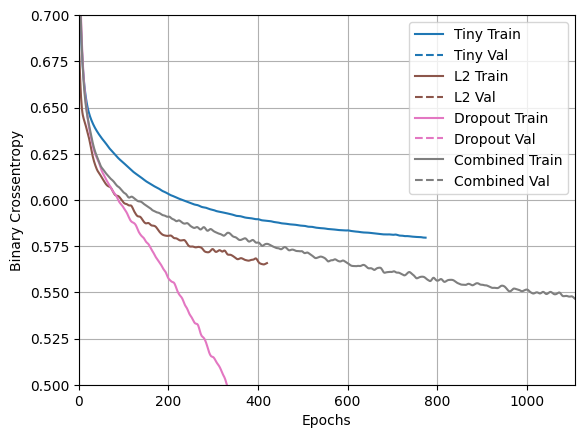

In [42]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

Este modelo com as regularizações combinadas (`"Combined"`) é obviamente o melhor até agora.

### Avaliando os resultados no *TensorBoard*


Esses modelos também registraram logs do TensorBoard.

Para abrir um visualizador de tensorboard incorporado em um notebook, copie o seguinte em uma célula de código:

```
%tensorboard --logdir {logdir}/regularizers
```

In [43]:
tensorboard --logdir {logdir}/regularizers

<IPython.core.display.Javascript object>

#### **ToDo:** Análise dos resultados (10pt)



```
# Isto está formatado como código
```

O que você pode inferir analisando os resultados apresentados no TensorBoard?

Pode ser observado que o modelo combinado, L2 e Dropout apresentaram a melhor performance em termos de generalização, com uma perda de validação que se estabilizou em um valor mais baixo e consistente ao longo das iterações, logo, evitando o overfitting, equilibrando o aprendizado do modelo. O modelo que utilizou apenas Dropout também mostrou bons resultados, mas com uma leve variação na perda, sugerindo que o Dropout sozinho não foi tão bom quanto a combinação. Já o modelo que utilizou apenas L2 apresentou uma performance intermediária, com uma perda de validação maior que a do modelo combinado, mas ainda melhor que o modelo sem regularização. Em geral, a utilização de regularizações melhorou a capacidade do modelo de generalizar, com o modelo combinado mostrando a melhor estabilidade ao longo do treinamento.









# Avaliando estrátegias de *overfitting* e regularização para a base de gato/não-gato

Para essa próxima tarefa, avalie três modelos (semelhante ao que foi feito para a base de Higgs). Você deve treinar:
- Um modelo pequeno.
- Um modelo médio.
- Um modelo grande.

Criando uma variável para guardar a história dos modelos treinados.

In [ ]:
cat_histories = {}

## **ToDo:** Lendo os dados da base de gatos/não-gatos (10pt)

In [46]:
import h5py
import numpy as np
from google.colab import drive
# Montar o Google Drive
drive.mount('/content/drive')
# Caminhos dos arquivos
train_file_path = '/content/drive/My Drive/Colab Notebooks/Trabalho_CAM_304_2024/train_catvnoncat.h5'
test_file_path = '/content/drive/My Drive/Colab Notebooks/Trabalho_CAM_304_2024/test_catvnoncat.h5'



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [58]:
# Carregando os dados
with h5py.File(train_file_path, 'r') as train_file:
    X_train = np.array(train_file['train_set_x'])  # Imagens de treino
    Y_train = np.array(train_file['train_set_y'])  # Rótulos de treino

with h5py.File(test_file_path, 'r') as test_file:
    X_test = np.array(test_file['test_set_x'])  # Imagens de teste
    Y_test = np.array(test_file['test_set_y'])  # Rótulos de teste


In [59]:
# Normalizando os dados
X_train = X_train / 255.0
X_test = X_test / 255.0

In [62]:
# Ajustando a forma dos dados para garantir que estão no formato correto (64, 64, 3)
if len(X_train.shape) == 2 or X_train.shape[-1] != 3:
    # Aqui vamos assumir que cada imagem deve ser reshaped para (64, 64, 3)
    X_train = X_train.reshape((-1, 64, 64, 3))
    X_test = X_test.reshape((-1, 64, 64, 3))


In [63]:
# Verificação dos shapes
print(f"X_train shape: {X_train.shape}")
print(f"Y_train shape: {Y_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"Y_test shape: {Y_test.shape}")

X_train shape: (209, 64, 64, 3)
Y_train shape: (209,)
X_test shape: (50, 64, 64, 3)
Y_test shape: (50,)


## **ToDo:** Treinando um modelo pequeno (10pt)

In [68]:
modelo_pequeno = tf.keras.Sequential([
    layers.Flatten(input_shape=(64, 64, 3)),  # Achatar a entrada de (64, 64, 3) para (64 * 64 * 3)
    layers.Dense(16, activation='relu'),       # Camada oculta pequena
    layers.Dense(1, activation='sigmoid')      # Saída binária
])

# Função para compilar e treinar o modelo
def compile_and_fit(model, name, max_epochs=100):
    optimizer = get_optimizer()
    model.compile(optimizer=optimizer,
                  loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
                  metrics=[tf.keras.losses.BinaryCrossentropy(from_logits=True, name='binary_crossentropy'),
                           'accuracy'])

    model.summary()

    history = model.fit(
        X_train, Y_train,
        validation_data=(X_test, Y_test),
        epochs=max_epochs,
        callbacks=get_callbacks(name),
        verbose=0
    )
    return history

cat_histories = {}
cat_histories['Pequeno'] = compile_and_fit(modelo_pequeno, 'sizes/Pequeno')

Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_9 (Flatten)                  │ (None, 12288)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_62 (Dense)                     │ (None, 16)                  │         196,624 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_63 (Dense)                     │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 196,641 (768.13 KB)

 Trainable params: 196,641 (768.13 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5646,  binary_crossentropy:1.2928,  loss:1.3433,  val_accuracy:0.3400,  val_binary_crossentropy:1.2964,  val_loss:1.3659,  
....................................................................................................

## **ToDo:** Treinando um modelo médio (10pt)

In [69]:
modelo_medio = tf.keras.Sequential([
    layers.Flatten(input_shape=(X_train.shape[1:])),  # Achatar a entrada
    layers.Dense(64, activation='relu'),  # Camada oculta com mais neurônios que o modelo pequeno
    layers.Dense(32, activation='relu'),  # Mais uma camada oculta para aumentar a capacidade do modelo
    layers.Dense(1, activation='sigmoid')  # Saída binária
])
cat_histories['Medio'] = compile_and_fit(modelo_medio, 'sizes/Medio')

Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_10 (Flatten)                 │ (None, 12288)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_64 (Dense)                     │ (None, 64)                  │         786,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_65 (Dense)                     │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_66 (Dense)                     │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 788,609 (3.01 MB)

 Trainable params: 788,609 (3.01 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5933,  binary_crossentropy:0.8206,  loss:0.8303,  val_accuracy:0.7400,  val_binary_crossentropy:0.5542,  val_loss:0.5399,  
....................................................................................................

## **ToDo:** Treinando um modelo grande (10pt)

In [70]:
modelo_grande = tf.keras.Sequential([
    layers.Flatten(input_shape=(X_train.shape[1:])),  # Achatar a entrada
    layers.Dense(256, activation='relu'),  # Camada oculta com muitos neurônios
    layers.Dense(128, activation='relu'),  # Outra camada oculta maior que o modelo médio
    layers.Dense(64, activation='relu'),  # Camada adicional
    layers.Dense(1, activation='sigmoid')  # Saída binária
])
cat_histories['Grande'] = compile_and_fit(modelo_grande, 'sizes/Grande')

Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_11 (Flatten)                 │ (None, 12288)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_67 (Dense)                     │ (None, 256)                 │       3,145,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_68 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_69 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_70 (Dense)                     │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,187,201 (12.16 MB)

 Trainable params: 3,187,201 (12.16 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5407,  binary_crossentropy:1.0998,  loss:1.1289,  val_accuracy:0.6800,  val_binary_crossentropy:0.6199,  val_loss:0.6131,  
....................................................................................................

## **ToDo:** Avalie a adição de regularização aos modelos (10pt)

In [73]:
modelo_com_regularizacao = tf.keras.Sequential([
    layers.Flatten(input_shape=(X_train.shape[1:])),
    layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
    layers.Dropout(0.5),  # Dropout para evitar overfitting
    layers.Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
    layers.Dropout(0.5),  # Dropout para evitar overfitting
    layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
    layers.Dense(1, activation='sigmoid')  # Saída binária
])
cat_histories['Regularizacao'] = compile_and_fit(modelo_pequeno, 'sizes/Regularizacao')

Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_9 (Flatten)                  │ (None, 12288)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_62 (Dense)                     │ (None, 16)                  │         196,624 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_63 (Dense)                     │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 196,641 (768.13 KB)

 Trainable params: 196,641 (768.13 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.7416,  binary_crossentropy:1.1964,  loss:1.2160,  val_accuracy:0.5800,  val_binary_crossentropy:1.8359,  val_loss:1.9580,  
....................................................................................................

## Resultados do treinamento

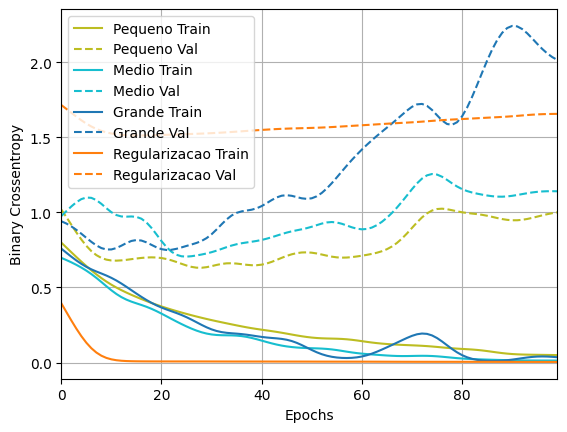

In [74]:
plotter.plot(cat_histories)
# plt.ylim([0.5, 0.7])

## **ToDo:** Análise dos resultados (10pt)

Avalia os modelos treinados quanto a Acurácia, F1-score, Precisão e revocação.

Dica: utilize a função [`classification_report`](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html) da sklearn.

In [76]:
from sklearn.metrics import classification_report

In [77]:
# Para o modelo pequeno
Y_pred_pequeno = (modelo_pequeno.predict(X_test) > 0.5).astype(int)
print("Modelo Pequeno:")
print(classification_report(Y_test, Y_pred_pequeno))

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Modelo Pequeno:
              precision    recall  f1-score   support

           0       0.57      0.76      0.65        17
           1       0.85      0.70      0.77        33

    accuracy                           0.72        50
   macro avg       0.71      0.73      0.71        50
weighted avg       0.75      0.72      0.73        50



In [78]:
# Para o modelo médio
Y_pred_medio = (modelo_medio.predict(X_test) > 0.5).astype(int)
print("Modelo Médio:")
print(classification_report(Y_test, Y_pred_medio))

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Modelo Médio:
              precision    recall  f1-score   support

           0       0.62      0.76      0.68        17
           1       0.86      0.76      0.81        33

    accuracy                           0.76        50
   macro avg       0.74      0.76      0.75        50
weighted avg       0.78      0.76      0.76        50



In [79]:
# Para o modelo grande
Y_pred_grande = (modelo_grande.predict(X_test) > 0.5).astype(int)
print("Modelo Grande:")
print(classification_report(Y_test, Y_pred_grande))

1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Modelo Grande:
              precision    recall  f1-score   support

           0       0.48      0.71      0.57        17
           1       0.80      0.61      0.69        33

    accuracy                           0.64        50
   macro avg       0.64      0.66      0.63        50
weighted avg       0.69      0.64      0.65        50



In [80]:
# Para o modelo com regularização
Y_pred_regularizacao = (modelo_com_regularizacao.predict(X_test) > 0.5).astype(int)
print("Modelo com Regularização:")
print(classification_report(Y_test, Y_pred_regularizacao))

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Modelo com Regularização:
              precision    recall  f1-score   support

           0       0.35      0.53      0.42        17
           1       0.67      0.48      0.56        33

    accuracy                           0.50        50
   macro avg       0.51      0.51      0.49        50
weighted avg       0.56      0.50      0.51        50



O que você pode inferir analisando os resultados dos treinamentos para a base de gatos/não-gatos.


Temos que, o modelo pequeno obteve uma acurácia de 72%, com maior precisão para a classe 1 (gatos), indicando um bom equilíbrio entre precisão e recall. O modelo médio apresentou uma melhora geral, alcançando 76% de acurácia, mostrando que o aumento de capacidade beneficiou o desempenho. O modelo grande, com acurácia de 64%, apresentou sinais de overfitting, memorizando o treinamento mas não generalizando bem. O modelo com regularização teve a pior acurácia, 50%, sugerindo que a regularização foi excessiva, levando ao underfitting e dificultando o aprendizado. Assim, o modelo médio apresentou a melhor generalização, enquanto o grande e o regularizado tiveram problemas em capturar corretamente os padrões.